
HOMEWORK 9

In this homework, you are going to use the dlib face detector and apply it to an image of your liking. You can follow the procedure shown in lesson 9. Please always comment your code so I can see what you're doing :-)

For this homework we are not going to provide you with any code, you'll have to build the face detector on your own.
Step 0

Run the necessary imports.
Step 1

Load an image (any image that contains faces).
Step 2

Load the dlib face predictor.
Step 3

Run the predictor on your image.
Step 4

Draw bounding boxes around the detected faces and plot the image. Use different colour for each face.
Step 5 (optional)

Repeat the process with a different and more challenging image (more faces, smaller faces, people with glasses, hats, helmets, etc.). How does the detector perform? Is it robust?


    1.All imports I need in this work.

In [64]:
import cv2
import numpy as np
import dlib
import random
from random import randint
from matplotlib import pyplot as plt
plt.rcParams['figure.figsize'] = [15, 10]

    2. Gerenal functions used in the works:
1.Function to draw bounding boxes around the faces in different colors.
2.Function that set coordinates to draw the bb.

In [65]:
def colors():
    x = random.randint(0,255)
    y = random.randint(0,255)
    z = random.randint(0,255)
    color = (x, y, z)
    
    return color
    

def rect_to_bb(rect):
    # Dlib rect --> OpenCV rect
    x = rect.left()
    y = rect.top()
    w = rect.right() - x
    h = rect.bottom() - y

    return (x, y, w, h)

  3. Upload images and convert them into RGB.

In [66]:
img_1 = cv2.imread('assets/girls.JPG')
img_2 = cv2.imread('assets/my.jpg')
img_3 = cv2.imread('assets/m.jpg')
img_list = [img_1, img_2, img_3]


for idx,img in enumerate(img_list):
    img_list[idx] = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
#gray = cv2.cvtColor(img_1, cv2.COLOR_RGB2GRAY)


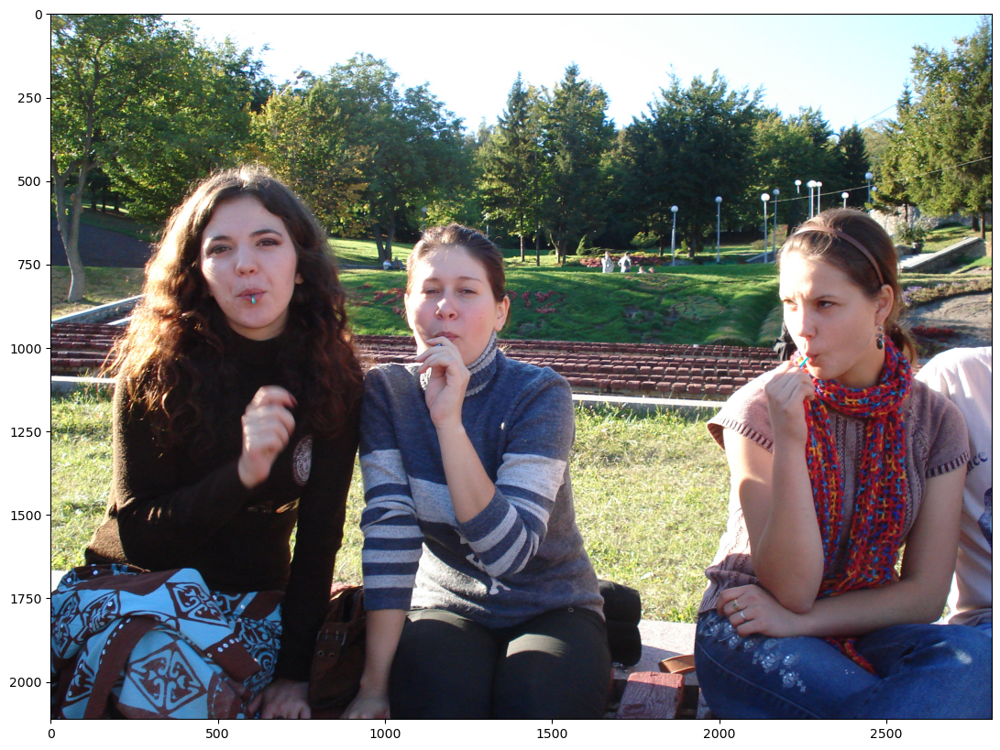

In [67]:
plt.imshow(img_list[0])


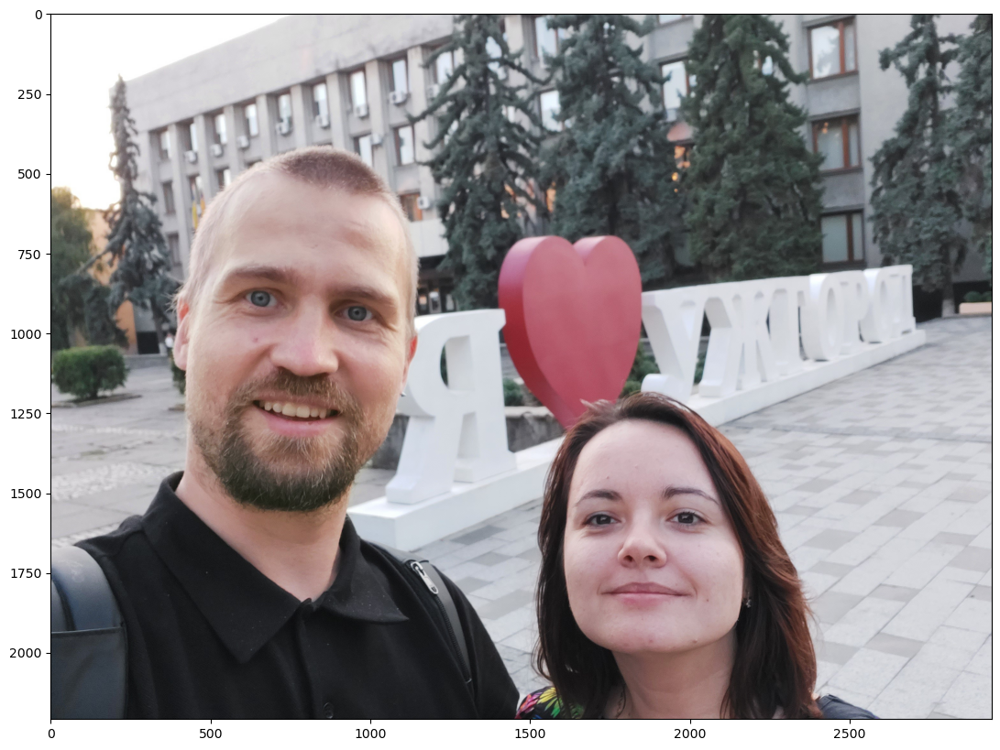

In [68]:
plt.imshow(img_list[1])

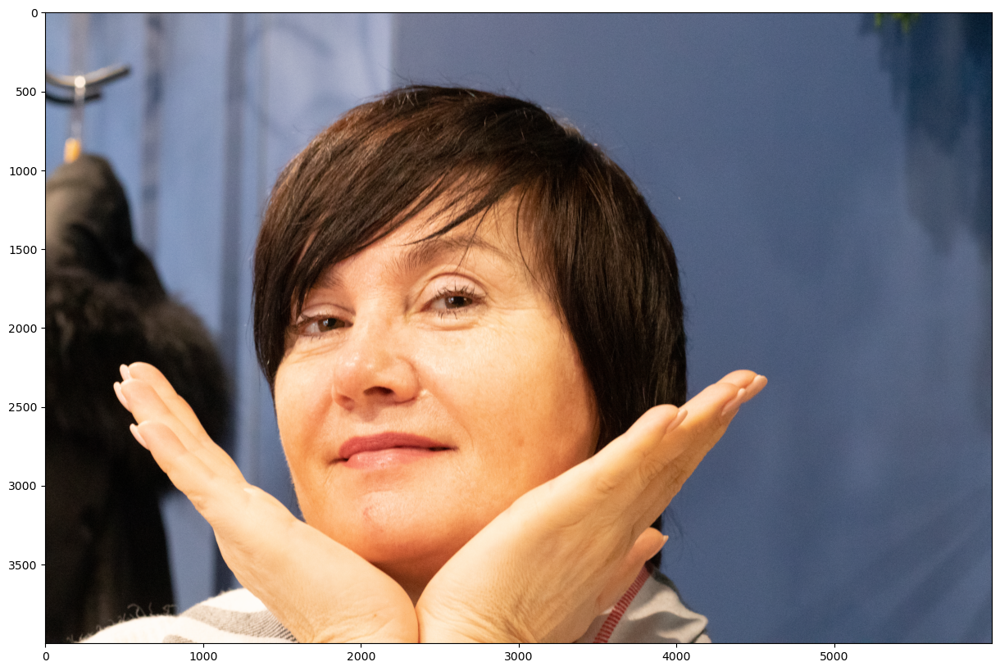

In [69]:
plt.imshow(img_list[2])

4.Loading the dlib detector.Trying to detect faces on the first image.

In [71]:
detector = dlib.get_frontal_face_detector()
# Detect faces, see http://dlib.net/face_detector.py.html
# 1 --> upsampling factor
rects = detector(img_list[0], 1)

print('Number of detected faces:', len(rects))
print(rects)

Number of detected faces: 2
rectangles[[(419, 598) (740, 919)], [(1062, 736) (1330, 1003)]]


5. Draw rectangles around the areas the detector considered as faces. It is expected that it detected corrected only the front faces.

(<matplotlib.image.AxesImage at 0x7ff5ac12aa00>, Text(0.5, 1.0, 'dlib_img_1'))

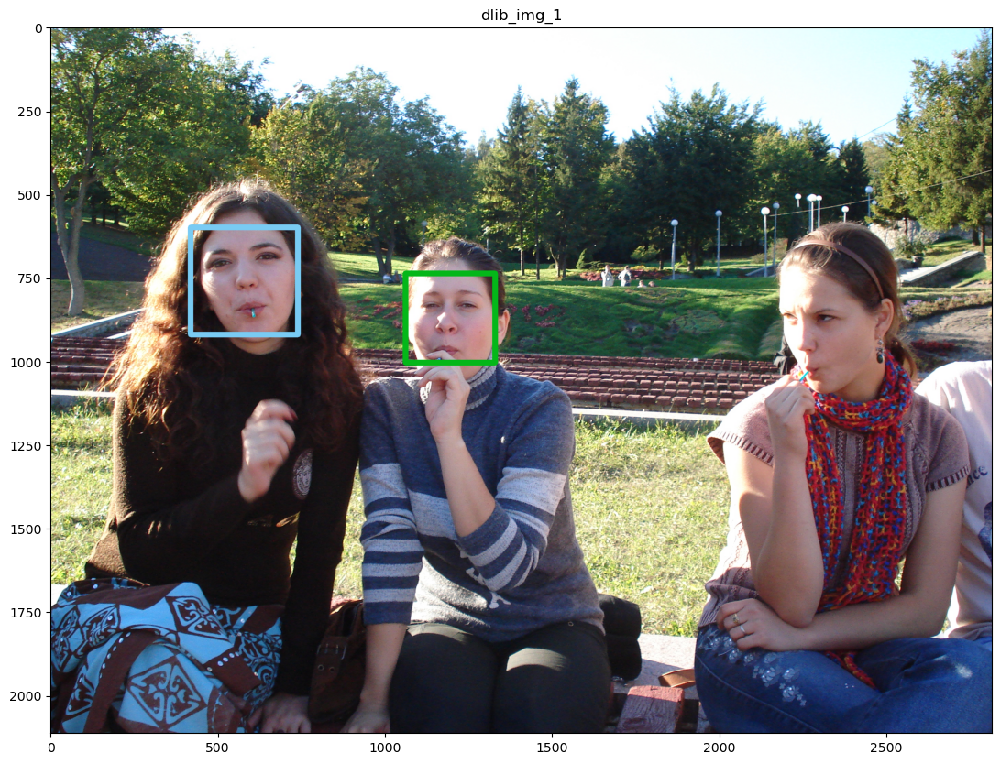

In [72]:
result_dlib = np.copy(img_list[0])
faces_dlib_img = []
for rect in rects:    
    # Draw rectangle around the face
    x, y, w, h = rect_to_bb(rect)
    color = colors()
    cv2.rectangle(result_dlib, (x, y), (x+w, y+h), color, 15)
    faces_dlib_img.append(img[y:y+h, x:x+w, :])
    

plt.imshow(result_dlib), plt.title('dlib_img_1')

Number of detected faces: 2
rectangles[[(1589, 1404) (2143, 1959)], [(425, 692) (1224, 1491)]]
1589 1404 554 555
425 692 799 799


(<matplotlib.image.AxesImage at 0x7ff5ac1171c0>, Text(0.5, 1.0, 'dlib_img_2'))

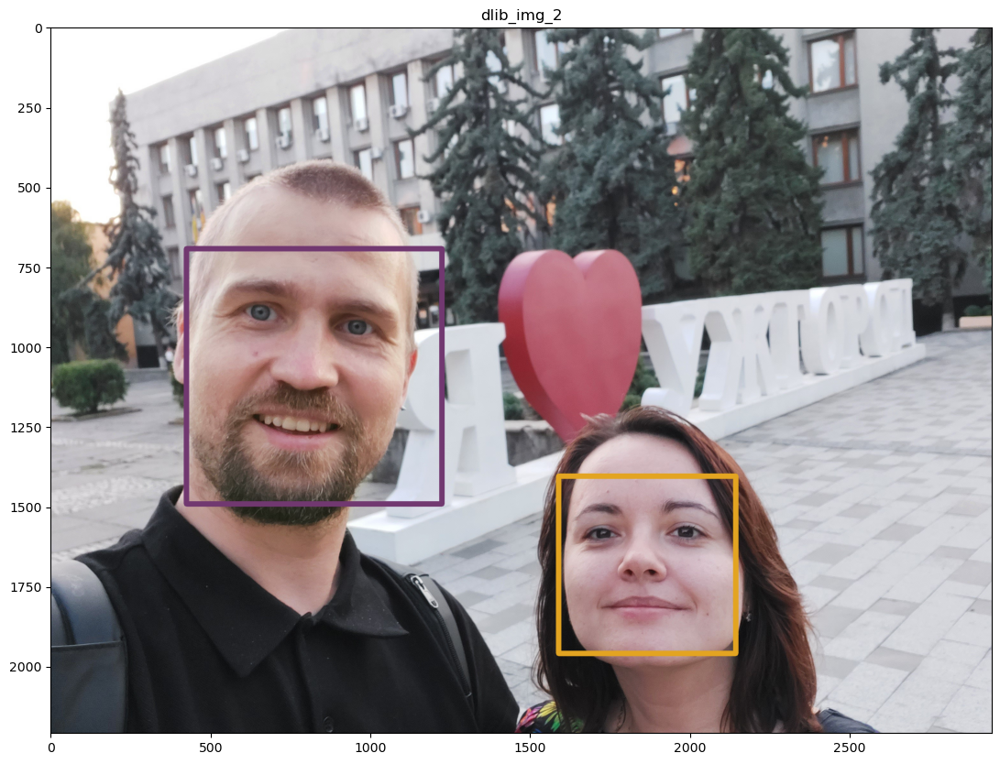

In [73]:
#The same procedure for the second image
rects = detector(img_list[1], 1)

print('Number of detected faces:', len(rects))
print(rects)
result_dlib = np.copy(img_list[1])
faces_dlib_img = []
for rect in rects:    
    x, y, w, h = rect_to_bb(rect)
    print(x, y, w, h)
    color = colors()
    cv2.rectangle(result_dlib, (x, y), (x+w, y+h), color, 15)
    faces_dlib_img.append(img[y:y+h, x:x+w, :])
    

plt.imshow(result_dlib), plt.title('dlib_img_2')

1282 1282 1987 1987


(<matplotlib.image.AxesImage at 0x7ff5ac06ee50>, Text(0.5, 1.0, 'dlib_img_3'))

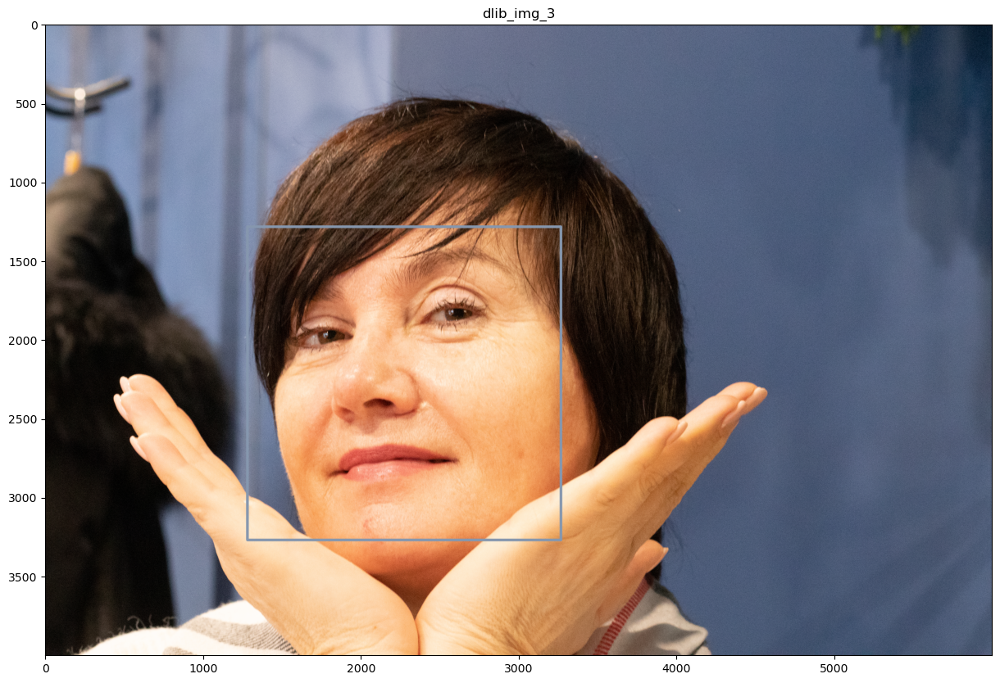

In [74]:
#The same procedure for the third image
rects = detector(img_list[2], 1)
result_dlib = np.copy(img_list[2])
faces_dlib_img = []
for rect in rects:    
    # Draw rectangle around the face
    x, y, w, h = rect_to_bb(rect)
    print(x, y, w, h)
    color = colors()
    cv2.rectangle(result_dlib, (x, y), (x+w, y+h), color, 15)
    faces_dlib_img.append(img[y:y+h, x:x+w, :])
    

plt.imshow(result_dlib), plt.title('dlib_img_3')

6. I repeat the same actions with Viola-Jones detector based on Haar cascades. It is interesting that Viola-Jones detector allows to detect the face that is not frontal (on the first image). However, false detection is also present. I also changed the **minNeighbors** parameter to avoid the odd detections.

In [75]:
casc_path = 'assets/haarcascade_frontalface_default.xml'
face_cascade = cv2.CascadeClassifier(casc_path)

Number of detected faces: 5


(<matplotlib.image.AxesImage at 0x7ff5a7f11ee0>, Text(0.5, 1.0, 'img_1'))

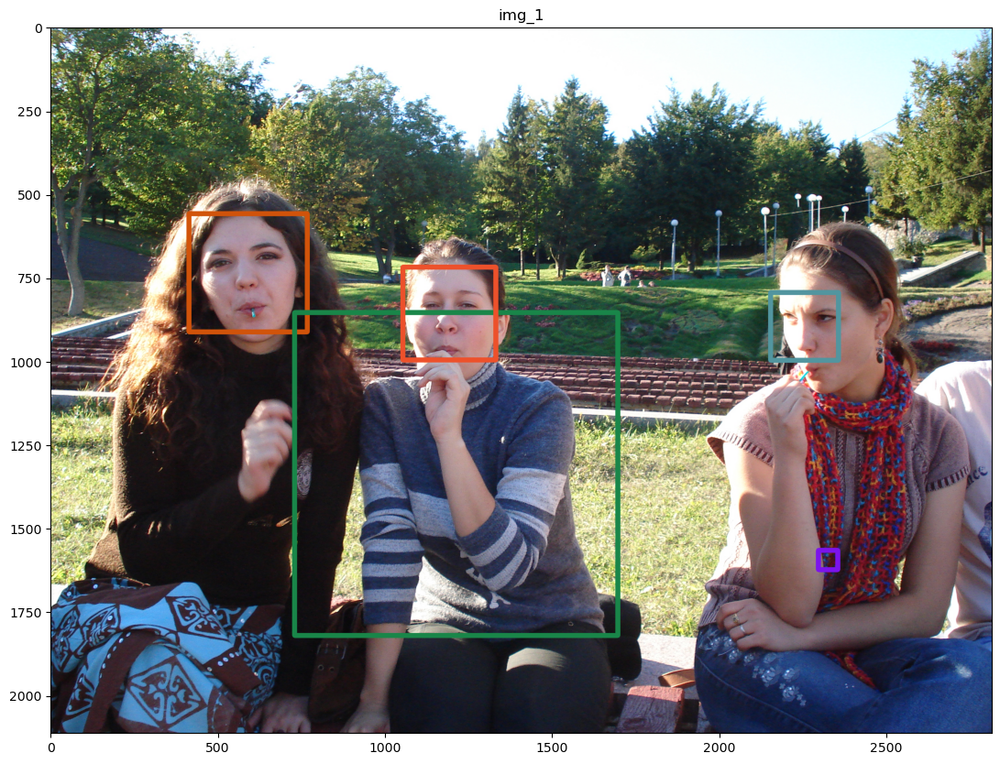

In [79]:
# minNeighbors = 0 shows all the detection at all scale, a value of approx. 5 shall felter out all the spurious detections
faces = face_cascade.detectMultiScale(img_list[0], scaleFactor=1.1, minNeighbors=8, flags=cv2.CASCADE_SCALE_IMAGE)

print('Number of detected faces:', len(faces))

# Draw rectangle around each face

result = np.copy(img_list[0])
faces_img = []
for (x, y, w, h) in faces: 
    color = colors()
    # Draw rectangle around the face
    cv2.rectangle(result, (x, y), (x+w, y+h), color, 14)
    faces_img.append(img[y:y+h, x:x+w, :])
    
plt.imshow(result), plt.title('img_1')


Number of detected faces: 2


(<matplotlib.image.AxesImage at 0x7ff5a7e890a0>, Text(0.5, 1.0, 'img_2'))

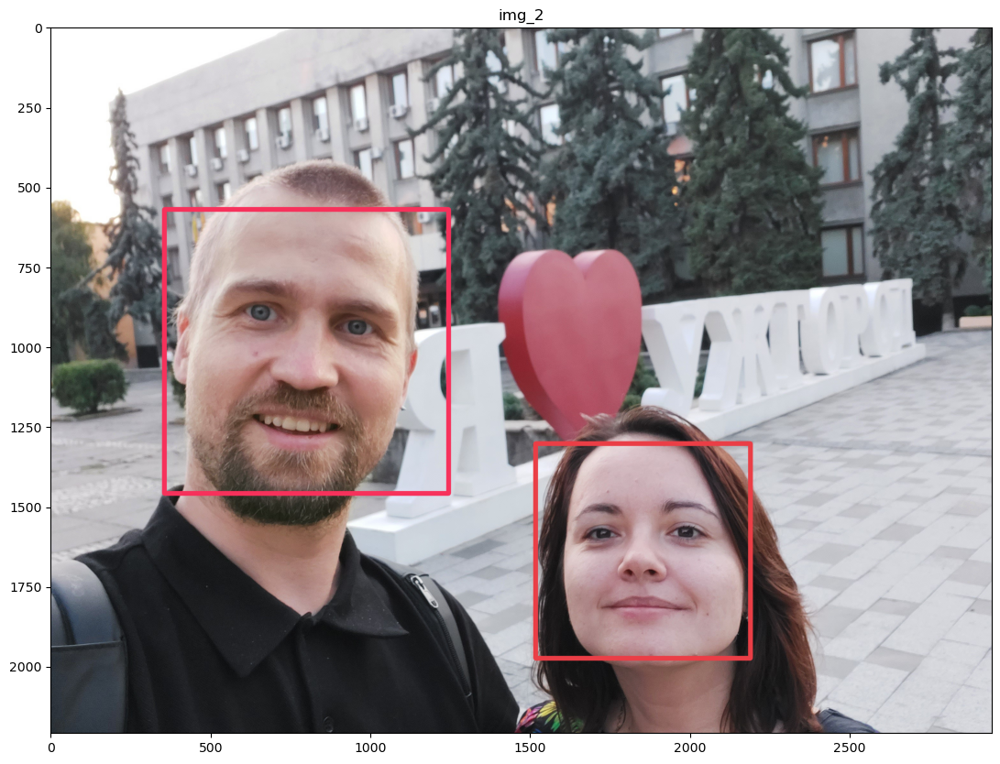

In [80]:
faces = face_cascade.detectMultiScale(img_list[1], scaleFactor=1.1, minNeighbors=8, flags=cv2.CASCADE_SCALE_IMAGE)

print('Number of detected faces:', len(faces))

# Draw rectangle around each face

result = np.copy(img_list[1])
faces_img = []
for (x, y, w, h) in faces: 
    color = colors()
    # Draw rectangle around the face
    cv2.rectangle(result, (x, y), (x+w, y+h), color, 14)
    faces_img.append(img[y:y+h, x:x+w, :])
    
plt.imshow(result), plt.title('img_2')

Number of detected faces: 1


(<matplotlib.image.AxesImage at 0x7ff5a7e74220>, Text(0.5, 1.0, 'img_3'))

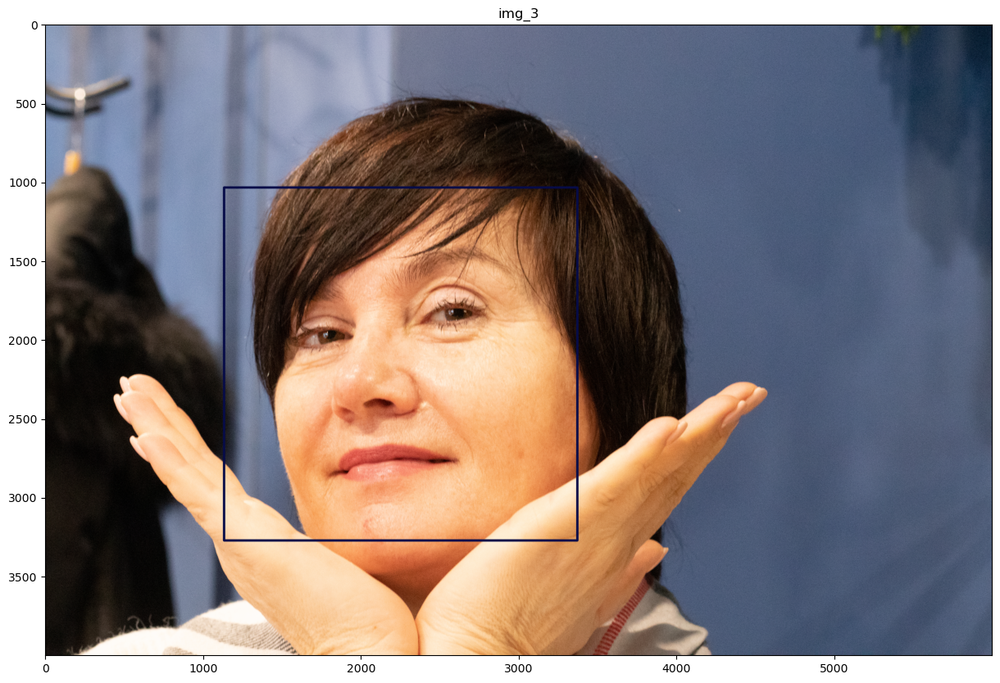

In [81]:
faces = face_cascade.detectMultiScale(img_list[2], scaleFactor=1.1, minNeighbors=8, flags=cv2.CASCADE_SCALE_IMAGE)

print('Number of detected faces:', len(faces))

# Draw rectangle around each face

result = np.copy(img_list[2])
faces_img = []
for (x, y, w, h) in faces: 
    color = colors()
    # Draw rectangle around the face
    cv2.rectangle(result, (x, y), (x+w, y+h), color, 14)
    faces_img.append(img[y:y+h, x:x+w, :])
    
plt.imshow(result), plt.title('img_3')

8.And the last try with the **hogFaceDetector** 

(<matplotlib.image.AxesImage at 0x7ff5a7c093a0>, Text(0.5, 1.0, 'img_1'))

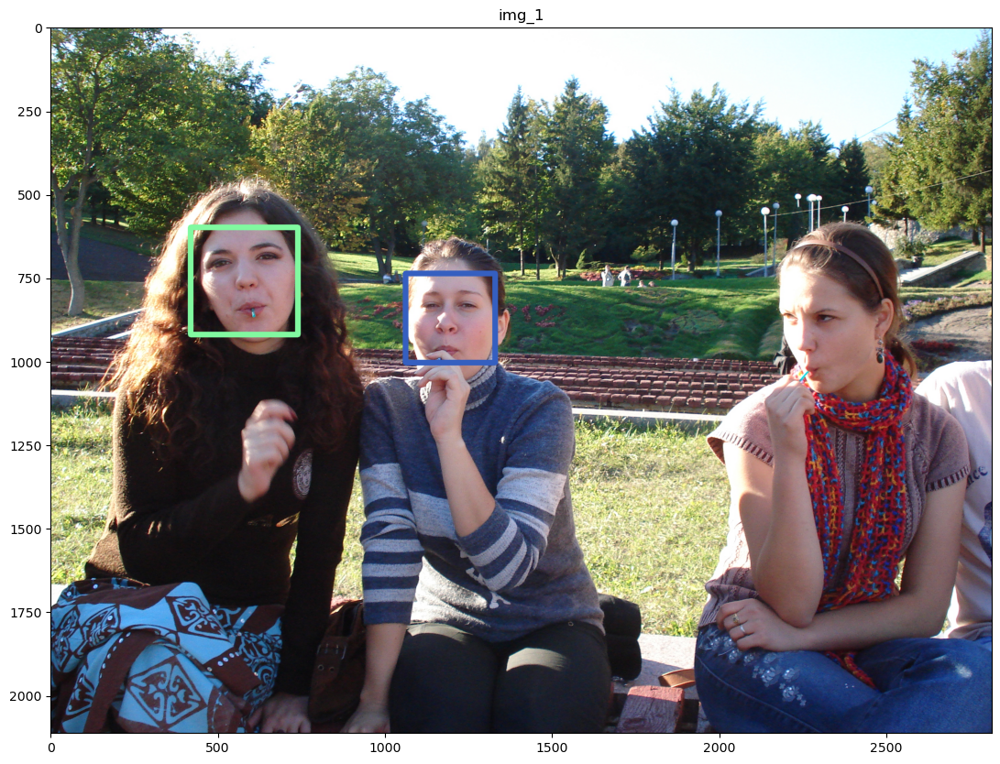

In [86]:
hogFaceDetector = dlib.get_frontal_face_detector()
faceRects = hogFaceDetector(img_list[0], 1)

   # Draw rectangle around each face
result_dlib = np.copy(img_list[0])
faces_dlib_img = []
for rect in faceRects:    
    # Draw rectangle around the face
    x, y, w, h = rect_to_bb(rect)
    color = colors()
    cv2.rectangle(result_dlib, (x, y), (x+w, y+h), color, 15)
    faces_dlib_img.append(img[y:y+h, x:x+w, :])
    

plt.imshow(result_dlib), plt.title('img_1')

(<matplotlib.image.AxesImage at 0x7ff5a7bf1520>, Text(0.5, 1.0, 'img_2'))

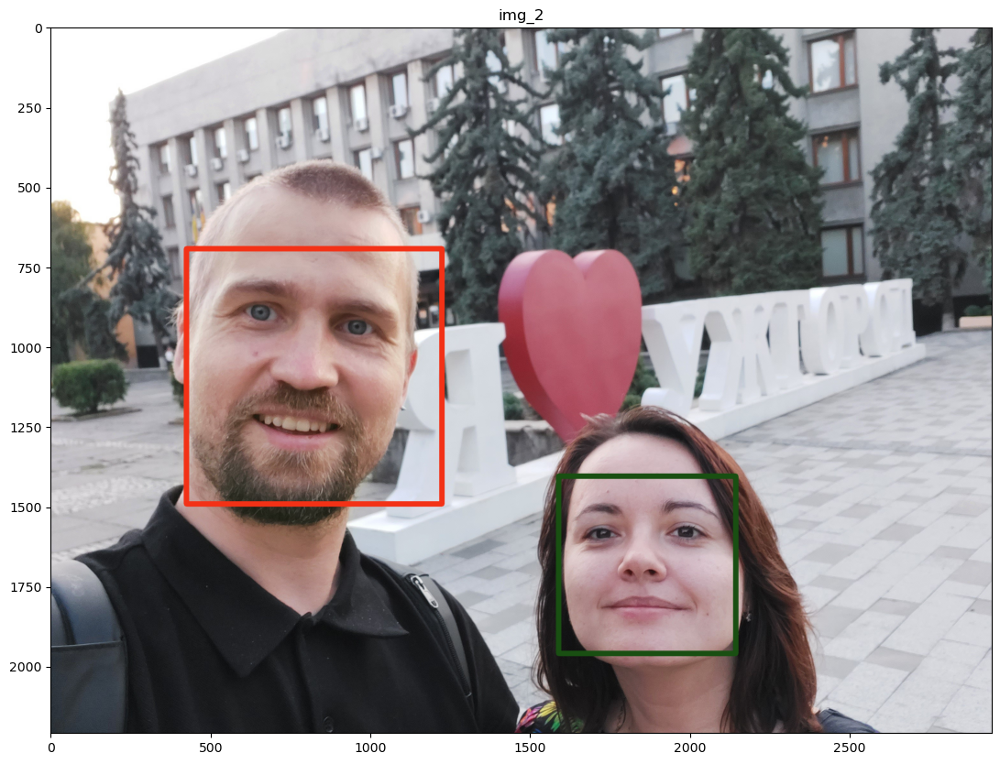

In [87]:
hogFaceDetector = dlib.get_frontal_face_detector()
faceRects = hogFaceDetector(img_list[1], 1)

   # Draw rectangle around each face
result_dlib = np.copy(img_list[1])
faces_dlib_img = []
for rect in faceRects:    
    # Draw rectangle around the face
    x, y, w, h = rect_to_bb(rect)
    color = colors()
    cv2.rectangle(result_dlib, (x, y), (x+w, y+h), color, 15)
    faces_dlib_img.append(img[y:y+h, x:x+w, :])
    

plt.imshow(result_dlib), plt.title('img_2')

(<matplotlib.image.AxesImage at 0x7ff5a7b5f6a0>, Text(0.5, 1.0, 'dlib'))

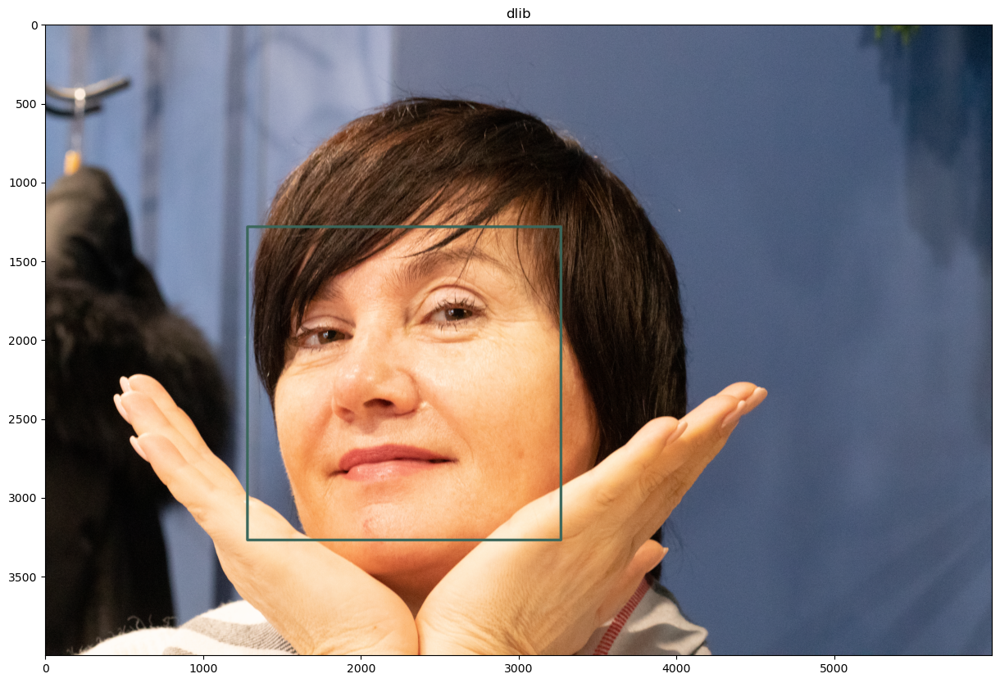

In [88]:
hogFaceDetector = dlib.get_frontal_face_detector()
faceRects = hogFaceDetector(img_list[2], 1)

   # Draw rectangle around each face
result_dlib = np.copy(img_list[2])
faces_dlib_img = []
for rect in faceRects:    
    # Draw rectangle around the face
    x, y, w, h = rect_to_bb(rect)
    color = colors()
    cv2.rectangle(result_dlib, (x, y), (x+w, y+h), color, 15)
    faces_dlib_img.append(img[y:y+h, x:x+w, :])
    

plt.imshow(result_dlib), plt.title('dlib')

Conclusions.
All face detectors work pretty similarly and mostly correctly detect the frontal faces. 